In [5]:
import os
import cv2
import math
import random
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.functional as TF

from PIL import Image, ImageOps
from shutil import copyfile
from cv2 import equalizeHist
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from matplotlib.lines import Line2D

In [2]:
def read_label(lpath):

    labels = []

    with open(lpath, 'r') as f:
        lines = f.readlines()
    for line in lines:
        x, y = tuple(line.strip().split(','))
        labels.append((int(x),int(y)))

    return labels

(2000, 3000, 3)


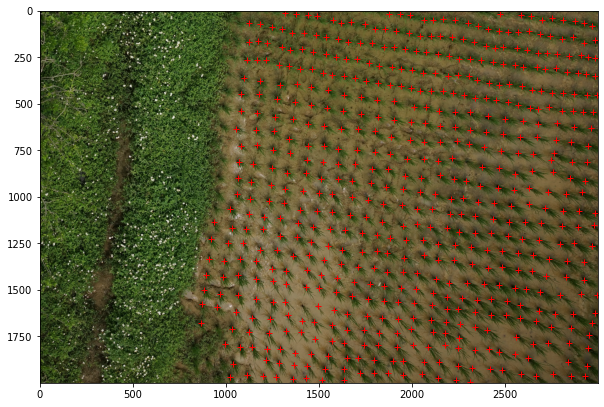

In [3]:
path = '.\\Train_Dev\\training\\DSC080814.JPG'
lpath = '.\\Train_Dev\\train_labels\\DSC080814.csv'
# path = './Train_Dev/training/DSC080454.JPG'

img = Image.open(path)
labels = read_label(lpath)

plt.figure(figsize=(10,10))
plt.imshow(img)
for label in labels:
    plt.plot(*label, 'r+')

print(np.array(img).shape)

In [23]:
arr = np.array(img)[0:150, 0:150]
feature = []

for x in range(arr.shape[0]):
    for y in range(arr.shape[1]):
        feature.append([x,y,*[color for color in arr[x,y]]])

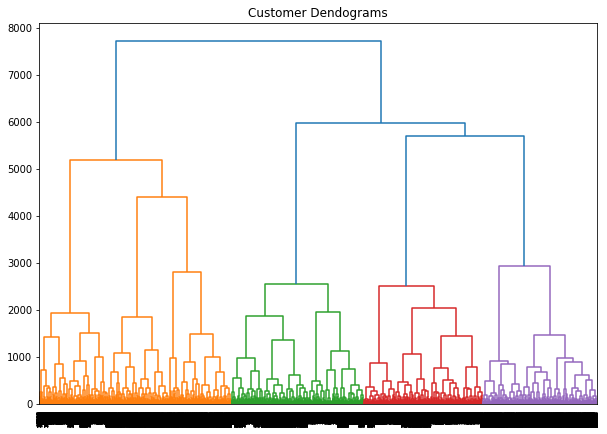

In [24]:
import scipy.cluster.hierarchy as shc

plt.figure(figsize=(10, 7))
plt.title("Customer Dendograms")
dend = shc.dendrogram(shc.linkage(feature, method='ward'))

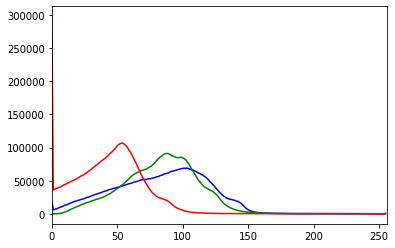

In [4]:
color = ('b', 'g', 'r')
for i,col in enumerate(color):
    histr = cv2.calcHist([np.array(img)],[i],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.show()

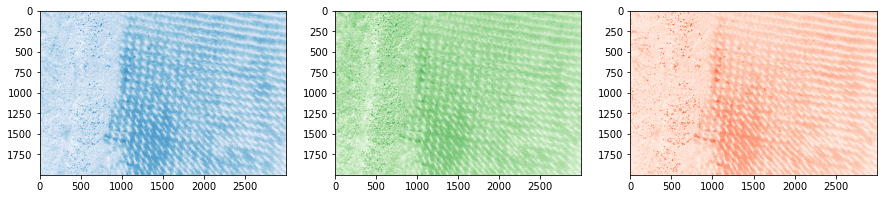

In [5]:
fig, ax = plt.subplots(1,3, figsize=(15,15))

ax[0].imshow(np.array(img)[:, :, 0], cmap='Blues')
ax[1].imshow(np.array(img)[:, :, 1], cmap='Greens')
ax[2].imshow(np.array(img)[:, :, 2], cmap='Reds')

In [6]:
train_dir = 'Train_Dev\\training'
train_pathes = [os.path.join(train_dir, fname) for fname in os.listdir(train_dir)]

label_dir = 'Train_Dev\\train_labels'
label_pathes = [os.path.join(label_dir, fname) for fname in os.listdir(label_dir)]

train_pathes.sort()
label_pathes.sort()

for i in range(5):
    print(train_pathes[i])
    print(label_pathes[i])
    print('=====')

Train_Dev\training\DSC080454.JPG
Train_Dev\train_labels\DSC080454.csv
=====
Train_Dev\training\DSC080552.JPG
Train_Dev\train_labels\DSC080552.csv
=====
Train_Dev\training\DSC080694.JPG
Train_Dev\train_labels\DSC080694.csv
=====
Train_Dev\training\DSC080814.JPG
Train_Dev\train_labels\DSC080814.csv
=====
Train_Dev\training\DSC080993.JPG
Train_Dev\train_labels\DSC080993.csv
=====


In [7]:
# random.seed(1)
# idxs = random.sample(list(range(0, len(train_pathes))), k=5)
# print(idxs)

idxs = [25, 4,7 ,1,2, 21]
# idxs = [4, 7, 1, 2, 13]

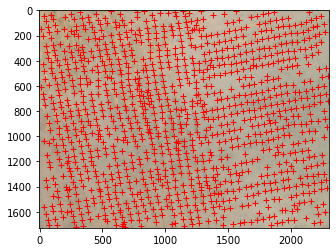

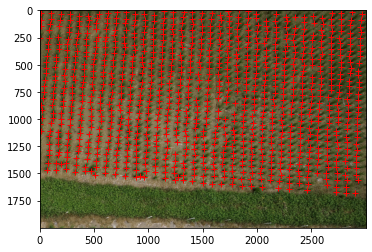

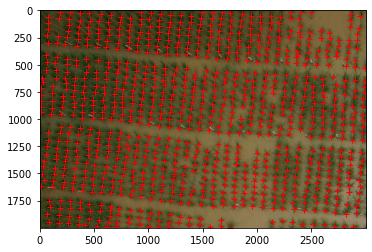

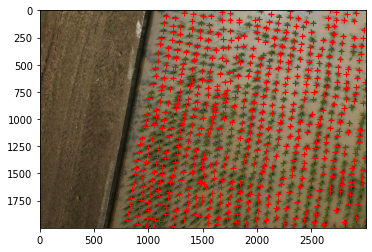

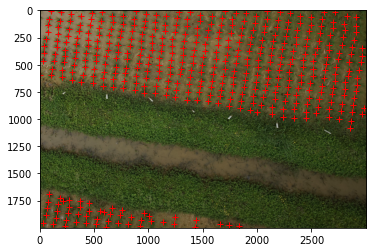

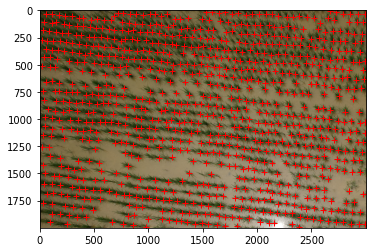

In [8]:
imgs = [Image.open(path) for path in train_pathes]
labels = [read_label(path) for path in label_pathes]

for idx in idxs:
    plt.figure()
    plt.imshow(imgs[idx])
    for label in labels[idx]:
        plt.plot(*label, 'r+')

255
0


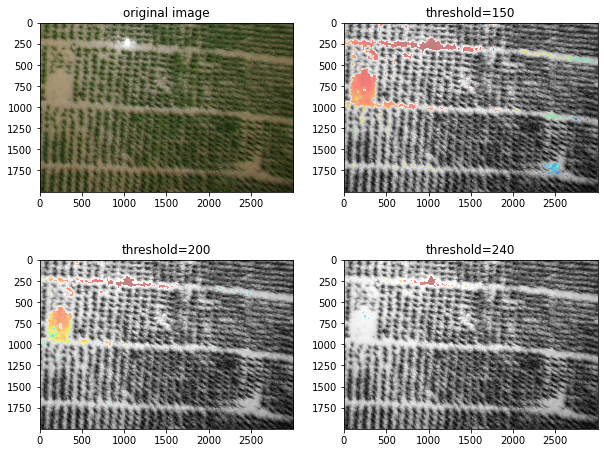

In [9]:
img = Image.open('Train_Dev\\training\\DSC082144.JPG')
gray_img = ImageOps.grayscale(img)

eqimg = equalizeHist(np.array(gray_img))

print(np.max(eqimg))
print(np.min(eqimg))

fig, ax = plt.subplots(2,2, figsize=(10,8))

ax[0,0].imshow(img)
ax[0,0].set_title('original image')

# first thresh
threshold = 150
msk = np.array(eqimg.shape)
msk = np.ma.masked_where(eqimg<=threshold, eqimg)

ax[0,1].set_title('threshold={}'.format(threshold))
ax[0,1].imshow(eqimg, cmap='gray')
ax[0,1].imshow(msk, alpha=0.5, cmap='jet')

# second thresh
threshold = 200
msk = np.array(eqimg.shape)
msk = np.ma.masked_where(eqimg<=threshold, eqimg)

ax[1,0].set_title('threshold={}'.format(threshold))
ax[1,0].imshow(eqimg, cmap='gray')
ax[1,0].imshow(msk, alpha=0.5, cmap='jet')

# third thresh
threshold = 240
msk = np.array(eqimg.shape)
msk = np.ma.masked_where(eqimg<=threshold, eqimg)

ax[1,1].set_title('threshold={}'.format(threshold))
ax[1,1].imshow(eqimg, cmap='gray')
ax[1,1].imshow(msk, alpha=0.5, cmap='jet')

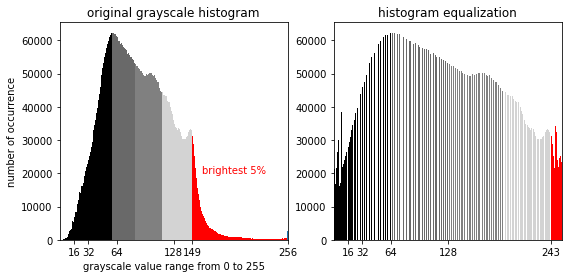

In [10]:
fig, ax = plt.subplots(1,2, figsize=(9, 4))

N, bins, patches = ax[0].hist(np.array(gray_img).ravel(), 256, [0,256])
ax[0].set_title('original grayscale histogram')

def get_quarter(ith):
    t = sum(N)/4 * ith
    for idx, n in enumerate(N):
        t -= n
        if t < 0:
            return idx

# legend_element = [
#     Line2D([0], [0], marker='*', color='lightgrey', label='<=25%', markersize=10),
#     Line2D([0], [0], marker='*', color='grey', label='<=50%', markersize=10),
#     Line2D([0], [0], marker='*', color='dimgrey', label='<=75%', markersize=10),
#     Line2D([0], [0], marker='*', color='black', label='<=100%', markersize=10),
# ]
# ax[0].legend(handles=legend_element)

for i in range(0, get_quarter(1)):
    patches[i].set_facecolor('black')
# ax[0].text(4, 40000, '{:.3f}%'.format(sum(N[:get_quarter(1)])/sum(N)), color='lightgrey')

for i in range(get_quarter(1), get_quarter(2)):
    patches[i].set_facecolor('dimgrey')
# ax[0].text(100, 55000, '{:.3f}%'.format(sum(N[get_quarter(1):get_quarter(2)])/sum(N)), color='grey')

for i in range(get_quarter(2), get_quarter(3)):
    patches[i].set_facecolor('grey')
# ax[0].text(200, 30000, '{:.3f}%'.format(sum(N[get_quarter(2):get_quarter(3)])/sum(N)), color='dimgrey')

for i in range(get_quarter(3), 255):
    patches[i].set_facecolor('lightgrey')
# ax[0].text(200, 30000, '{:.3f}%'.format(sum(N[get_quarter(3):])/sum(N)), color='black')

for i in range(get_quarter(3.8), 255):
    patches[i].set_facecolor('red')
ax[0].text(160, 20000, 'brightest 5%', color='red')

ax[0].set_xlim([0,255])
ax[0].set_xticks([math.pow(2, i) for i in range(4,9)] + [get_quarter(3.8)])

ax[0].set_ylabel('number of occurrence')
ax[0].set_xlabel('grayscale value range from 0 to 255')

#=====================================

N, bins, patches = ax[1].hist(eqimg.ravel(), 256, [0,256])
ax[1].set_title('histogram equalization')

for i in range(0, get_quarter(1)):
    patches[i].set_facecolor('black')
# ax[0].text(4, 40000, '{:.3f}%'.format(sum(N[:get_quarter(1)])/sum(N)), color='lightgrey')

for i in range(get_quarter(1), get_quarter(2)):
    patches[i].set_facecolor('dimgrey')
# ax[0].text(100, 55000, '{:.3f}%'.format(sum(N[get_quarter(1):get_quarter(2)])/sum(N)), color='grey')

for i in range(get_quarter(2), get_quarter(3)):
    patches[i].set_facecolor('grey')
# ax[0].text(200, 30000, '{:.3f}%'.format(sum(N[get_quarter(2):get_quarter(3)])/sum(N)), color='dimgrey')

for i in range(get_quarter(3), 256):
    patches[i].set_facecolor('lightgrey')
# ax[0].text(200, 30000, '{:.3f}%'.format(sum(N[get_quarter(3):])/sum(N)), color='black')

for i in range(get_quarter(3.8), 255):
    patches[i].set_facecolor('red')

ax[1].set_xlim([0,255])
ax[1].set_xticks([math.pow(2, i) for i in range(4,8)] + [get_quarter(3.8)])

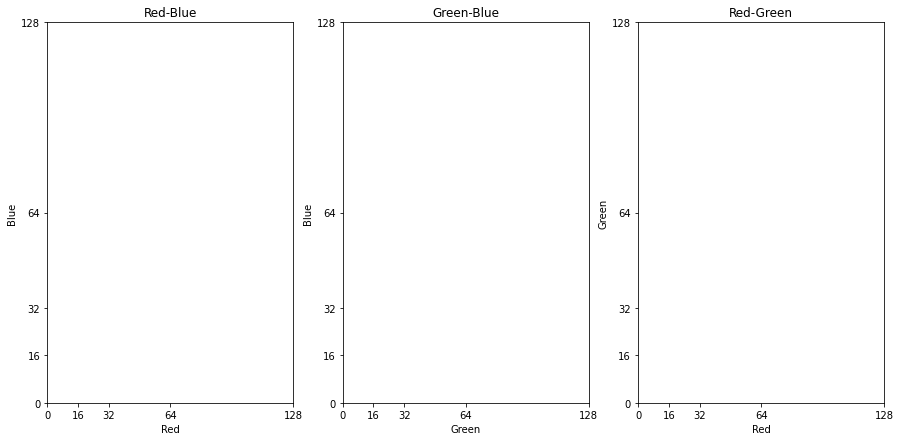

In [11]:
# plt.imshow(img)
import matplotlib.cm as cm

# img = Image.open(r'Train_Dev\training\IMG_170406_040351_0238_RGB4.JPG')
img = Image.open(r'Train_Dev\training\DSC080454.JPG')
arr = np.array(img)
rs = []
gs = []
bs = []
stride = 30
for i in range(0, arr.shape[0], stride):
    for j in range(0, arr.shape[1], 5):
        rs.append(arr[i,j,0])
        gs.append(arr[i,j,1])
        bs.append(arr[i,j,2])

colors=["#FF00FF", "#00FFFF", "#FFFF00"]
get_rgb = [str(hex(i))[2:].upper() if i >= 16 else '0' + str(hex(i))[-1].upper() for i in range(256)]


fig, ax = plt.subplots(1,3, figsize=(15,7))
# ax[0].scatter(rs, bs, color=colors[0])
# this section is exhasting to execute
# for r,g,b in zip(rs,gs, bs):
#     ax[0].plot(r,b, '.', color= '#' + get_rgb[r] + get_rgb[g] + get_rgb[b])
#     ax[1].plot(g,b, '.', color= '#' + get_rgb[r] + get_rgb[g] + get_rgb[b])
#     ax[2].plot(r,g, '.', color= '#' + get_rgb[r] + get_rgb[g] + get_rgb[b])

ax[0].set_title('Red-Blue')
ax[0].set_xlabel('Red')
ax[0].set_ylabel('Blue')
ax[0].set_xticks([math.pow(2,i) for i in range(4, 8)] + [0])
ax[0].set_yticks([math.pow(2,i) for i in range(4, 8)] + [0])

ax[1].set_title('Green-Blue')
ax[1].set_xlabel('Green')
ax[1].set_ylabel('Blue')
ax[1].set_xticks([math.pow(2,i) for i in range(4, 8)] + [0])
ax[1].set_yticks([math.pow(2,i) for i in range(4, 8)] + [0])

ax[2].set_title('Red-Green')
ax[2].set_xlabel('Red')
ax[2].set_ylabel('Green')
ax[2].set_xticks([math.pow(2,i) for i in range(4, 8)] + [0])
ax[2].set_yticks([math.pow(2,i) for i in range(4, 8)] + [0])

Text(0, 0.5, 'Blue')

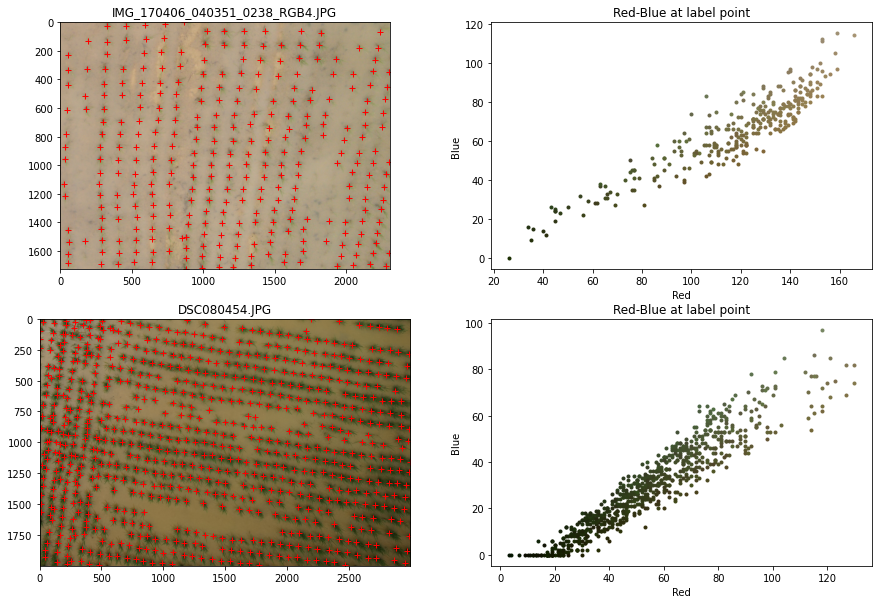

In [36]:
img1 = Image.open(r'Train_Dev\training\IMG_170406_040351_0238_RGB4.JPG')
img2 = Image.open(r'Train_Dev\training\DSC080454.JPG')

label1 = read_label(r'Train_Dev\train_labels\IMG_170406_040351_0238_RGB4.csv')
label2 = read_label(r'Train_Dev\train_labels\DSC080454.csv')

fig, ax = plt.subplots(2,2, figsize=(15,10))

ax[0,0].set_title('IMG_170406_040351_0238_RGB4.JPG')
ax[1,0].set_title('DSC080454.JPG')

rs1, gs1, bs1 = [], [], []
crs, cgs, cbs = [0]*256, [0]*256, [0]*256
for j, i in label1:
    rs1.append(arr[i,j,0])
    gs1.append(arr[i,j,1])
    bs1.append(arr[i,j,2])
    ax[0,0].plot(j, i, 'r+')

rs2, gs2, bs2 = [], [], []
crs, cgs, cbs = [0]*256, [0]*256, [0]*256
for j, i in label2:
    rs2.append(arr[i,j,0])
    gs2.append(arr[i,j,1])
    bs2.append(arr[i,j,2])
    ax[1,0].plot(j, i, 'r+')

ax[0,0].imshow(img1)
for r,g,b in zip(rs1,gs1,bs1):
    ax[0,1].plot(r, b, '.', color='#' + get_rgb[r] + get_rgb[g] + get_rgb[b])
ax[0,1].set_title('Red-Blue at label point')
ax[0,1].set_xlabel('Red')
ax[0,1].set_ylabel('Blue')

ax[1,0].imshow(img2)
for r,g,b in zip(rs2,gs2,bs2):
    ax[1,1].plot(r, b, '.', color='#' + get_rgb[r] + get_rgb[g] + get_rgb[b])
ax[1,1].set_title('Red-Blue at label point')
ax[1,1].set_xlabel('Red')
ax[1,1].set_ylabel('Blue')

21 days: 19, 48 days: 25


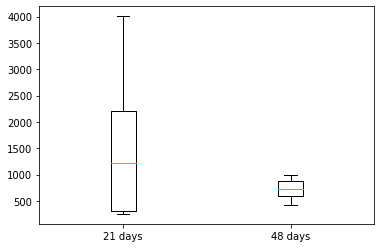

In [13]:
label_path_21 = [lp for lp in label_pathes if 'RGB' in lp]
label_path_48 = [lp for lp in label_pathes if not 'RGB' in lp]

cnt_label_21 = []
for label in label_path_21:
    cnt_label_21.append(len(read_label(label)))

cnt_label_48 = []
for label in label_path_48:
    cnt_label_48.append(len(read_label(label)))
      
plt.boxplot([cnt_label_21, cnt_label_48])
plt.xticks([1,2], ['21 days','48 days'])
print('21 days: {}, 48 days: {}'.format(len(cnt_label_21), len(cnt_label_48)))

21 days: 19, 48 days: 25


Text(0.5, 1.0, '48 days density (sorted)')

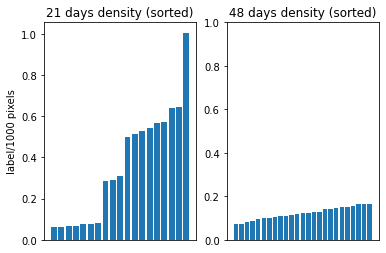

In [14]:
img_path_21 = [fp for fp in train_pathes if 'RGB' in fp]
img_path_48 = [fp for fp in train_pathes if not 'RGB' in fp]

print('21 days: {}, 48 days: {}'.format(len(img_path_21), len(img_path_48)))

img_size_21 = Image.open(img_path_21[0]).size
img_size_48 = Image.open(img_path_48[0]).size

dense_label_21, dense_label_48 = [], []

for cnt in cnt_label_21:

    dense_label_21.append(1000 * cnt/(lambda x,y: x*y)(*img_size_21))

for cnt in cnt_label_48:

    dense_label_48.append(1000 * cnt/(lambda x,y: x*y)(*img_size_48))

fig, ax = plt.subplots(1,2)

ax[0].bar(list(range(len(dense_label_21))), sorted(dense_label_21))
ax[0].set_xticks([])
ax[0].set_yticks([i/10 for i in range(0,11,2)])
ax[0].set_title('21 days density (sorted)')
ax[0].set_ylabel('label/1000 pixels')

ax[1].bar(list(range(len(dense_label_48))), sorted(dense_label_48))
ax[1].set_xticks([])
ax[1].set_yticks([i/10 for i in range(0,11,2)])
ax[1].set_title('48 days density (sorted)')

In [ ]:
mini21 = r'miniRiceField_2/af21ds'

mini21i = os.path.join(mini21, 'images')
mini21l = os.paht.join(mini21, 'labels')

mini21_is = [os.path.join(mini21i, fp) for fp in os.listdir(mini21i)]
mini21_ls = [os.path.join(mini21l, fp) for fp in os.listdir(mini21l)]